In [1]:
import os
import time
import datetime
import matplotlib

import numpy as np
import pandas as pd
import rsfuncs as rs
import rasterio as rio
import geopandas as gp

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.animation as animation

from IPython.display import HTML
from pandas.plotting import register_matplotlib_converters
from pandas.tseries.offsets import MonthEnd

from shapely.ops import unary_union
from shapely.geometry import Polygon as shPolygon
from dateutil.relativedelta import relativedelta

from matplotlib.lines import Line2D
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon
from mpl_toolkits.basemap import Basemap
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

register_matplotlib_converters()
matplotlib.rcParams['animation.embed_limit'] = 2**128

# Load and format data

In [2]:
# Load shapefile of catchments
catchments = gp.read_file("../shape/sierra_catchments.shp")
# Find csvs containing remote sensing data for each catchment
files = [os.path.join("../data/RS_catchdat/",x) for x in os.listdir("../data/RS_catchdat/") if x.endswith(".csv")]

In [3]:
# Load csvs as dataframes 
dfdict = {os.path.split(x)[-1][:-4]:pd.read_csv(x) for x in files}

# Calc ensemble balance for watersheds

BEAR R 887.0472
0.43209119585872324 1.4450351945596391


/anaconda3/envs/pysheds/lib/python3.8/site-packages/pandas/core/indexing.py:845: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/anaconda3/envs/pysheds/lib/python3.8/site-packages/pandas/core/indexing.py:1048: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item_labels[indexer[info_axis]]] = value
<ipython-input-4-c9212786f982>:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer]

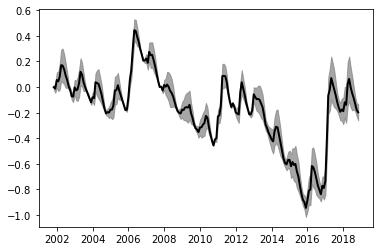

COSUMNES 1672.7633999999998
0.4826388187405293 1.6853890292407223


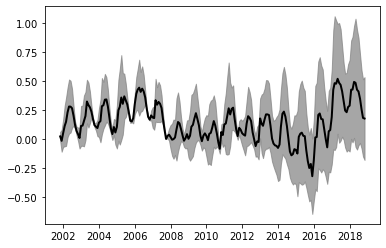

STANISLAUS R 2801.79
0.29897754966601836 1.3631505066421525


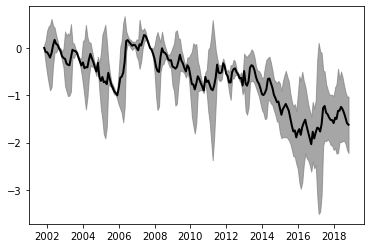

FEATHER R 11426.2893
0.3327531199274418 1.42265533900022


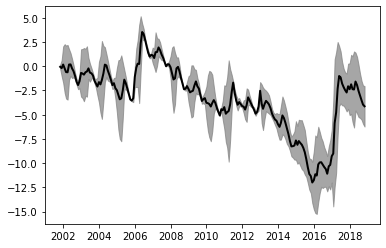

AMERICAN R 5838.2532
0.32889995456289944 1.2296413167716367


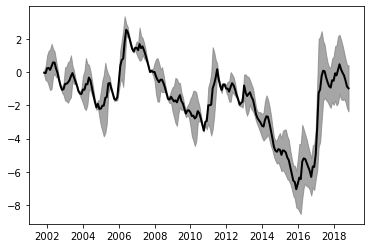

KAWEAH R 1954.9593
0.49192571583405786 2.4472205636652844


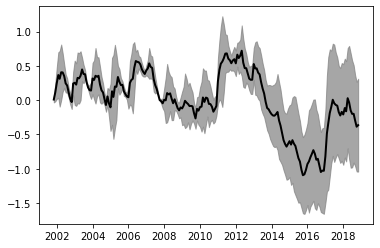

TULE R 1182.0492
0.6121208085665307 3.054463309143948


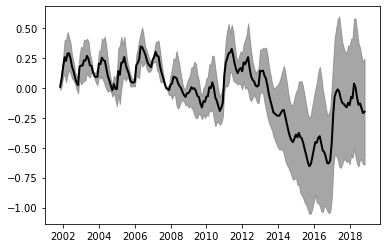

CALAVERAS R 1126.71
0.5631878535839313 2.1788811818838623


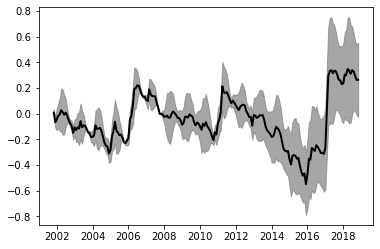

SACRAMENTO R 24146.043299999998
0.37888019511314697 1.8284397696725032


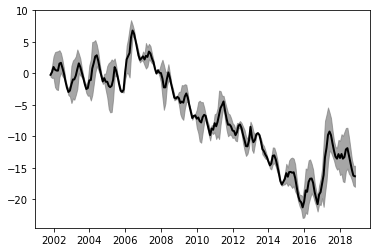

KINGS R 4702.4793
0.29941612365931497 1.7692591549017311


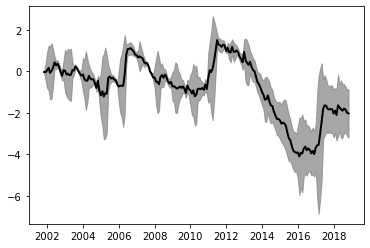

MERCED R 3215.7486
0.3557340662627332 1.784404843356081


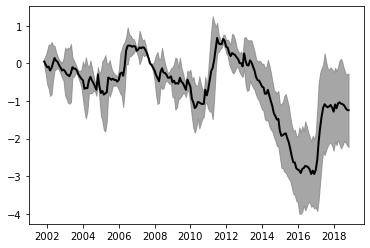

YUBA R 3495.3687
0.26943728282642637 0.943450113657037


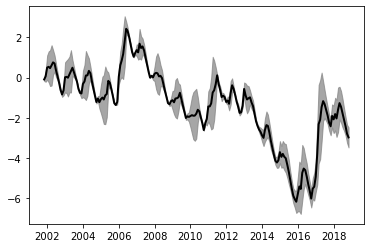

MOKELUMNE R 1771.0973999999999
0.3278278810745301 1.34976479484885


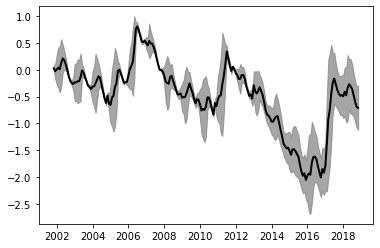

KERN R 6221.0511
0.3885466932703002 3.640806165376498


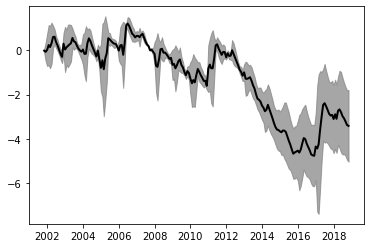

TUOLUMNE R 4722.405299999999
0.3020897182294204 1.5326680899204417


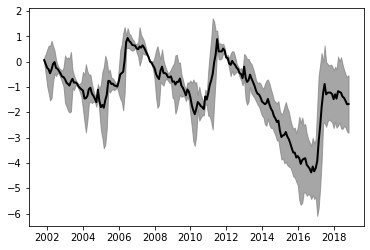

SAN JOAQUIN R 5003.086499999999
0.3041824633888428 1.7123647242875955


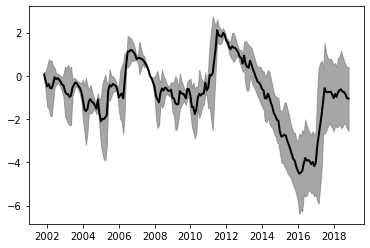

In [4]:
# Setup out dicts
dsdf_dict = {}
budyko_dict = {}
catch_ds = []

for k,v in dfdict.items():
    stid = k.split("_")[1]
    catch = catchments[catchments['stid'] == stid]
    print(catch.catch_name.values[0], catch.area_km2.values[0])
    df = rs.col_to_dt(v)
    
    if 'Sres_outlet' in df.columns:
        outflow = df['Sres_outlet'].diff()
    else:
        outflow = df['qout_km3']
    
    # We need to drop data to align with hydrologic years and account for nans. Filter to include 2002 - 2018
    startidx  = df.dropna().index[7]
    endidx  = df.dropna().index[-8]
    time_mask = (df.index > startidx) & (df.index <= endidx)
    adf = df[time_mask]
    
    # Compute an ensemble estimate for dS using MODIS ET, SSEBop ET, LRM SWE, Daymet SWE 
    adf.loc[:, ('ds1')] = adf['p_prism'] - adf['aet_modis'] - adf['swe_lrm'].diff() - adf['tc_sm'].diff() -  adf['Sres'].diff() - outflow
    adf.loc[:, ('ds2')] = adf['p_prism'] - adf['aet_modis'] - adf['dmet_swe'].diff() - adf['tc_sm'].diff() -  adf['Sres'].diff() - outflow
    adf.loc[:, ('ds3')] = adf['p_prism'] - adf['aet_ssebop'] - adf['swe_lrm'].diff() - adf['tc_sm'].diff() -  adf['Sres'].diff() - outflow
    adf.loc[:, ('ds4')] = adf['p_prism'] - adf['aet_ssebop'] - adf['dmet_swe'].diff() - adf['tc_sm'].diff() -  adf['Sres'].diff() - outflow
    
    # Since we computed differentials (.diff()), drop the first row
    adf = adf[1:]
    
    # Difference from 5 year baseline 
    ds1 = np.cumsum(adf['ds1'] - np.mean(adf['ds1'][:72]))
    ds2 = np.cumsum(adf['ds2'] - np.mean(adf['ds2'][:72]))
    ds3 = np.cumsum(adf['ds3'] - np.mean(adf['ds3'][:72]))
    ds4 = np.cumsum(adf['ds4'] - np.mean(adf['ds4'][:72]))
    
    # Get upper and lower bounds 
    dsdf = rs.col_to_dt(pd.DataFrame([ds1.index, 
                                      np.nanmin([ds1,ds2,ds3,ds4], axis = 0).astype(float), 
                                      np.nanmean([ds1,ds2,ds3,ds4], axis = 0).astype(float), 
                                      np.nanmax([ds1,ds2,ds3,ds4], axis = 0).astype(float)]).T)

    # Rename out cols 
    dsdf.columns = ['ds_min', 'ds_mean', 'ds_max']
    
    # Append to out dict 
    dsdf_dict[catch.catch_name.values[0]] = dsdf
    
    # Budyko analysis
    p_aet = df['aet_modis'].dropna().values.mean() / df['p_prism'].dropna().values.mean()
    p_pet = df['pet_modis'].dropna().values.mean() / df['p_prism'].dropna().values.mean() 

    print(p_aet,p_pet)
    
    budyko_dict[catch.catch_name.values[0]] = [p_aet, p_pet]
    
    # Get the total change in storage for each wshed, and write to shapefile
    catch['ds_sum'] = round(dsdf['ds_mean'].iloc[-1],3)
    catch_ds.append(catch)
    
    # Plot ds for each wshed 
    plt.plot(dsdf['ds_mean'], color = 'black',  linewidth=2, label = 'ds mean')
    plt.fill_between(dsdf.index, dsdf['ds_min'].astype(float), dsdf['ds_max'].astype(float), color = 'gray', alpha = 0.7, label = 'ds range')
    
    plt.show()


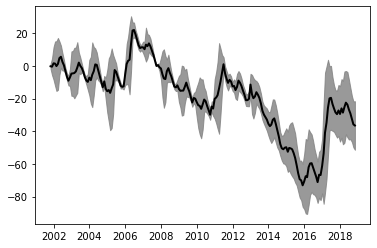

In [5]:
# Calc/Plot the cumulative sum for the whole Sierra 
net_ds = np.sum([v['ds_mean'].values for k,v in dsdf_dict.items()], axis = 0)
net_ds_max = np.sum([v['ds_max'].values for k,v in dsdf_dict.items()], axis = 0)
net_ds_min = np.sum([v['ds_min'].values for k,v in dsdf_dict.items()], axis = 0)

plt.plot(adf.index, net_ds, color = 'black', linewidth = 2)
plt.fill_between(adf.index, net_ds_min.astype(float),net_ds_max.astype(float), color = 'gray', alpha = 0.8)
plt.show()

# Append the sum to the out dict 
sndf = pd.DataFrame([net_ds,net_ds_max,net_ds_min]).T
sndf.columns = ['ds_mean', 'ds_max', 'ds_min']
sndf.index = dsdf_dict["SACRAMENTO R"].index
dsdf_dict['SIERRA NEVADA'] = sndf

# Concatenate the ΔS sum for each watershed we calculated in the last loop to a single gdf 
ds_catches = gp.GeoDataFrame(pd.DataFrame(pd.concat(catch_ds)))

# Calculate ΔS as cm - divide by the catchment area and convert km to cm (1e5)
ds_catches['ds_sum_cm'] = ds_catches['ds_sum'] / ds_catches['area_km2'] * 1e5

# Make a basemap plot with labels 

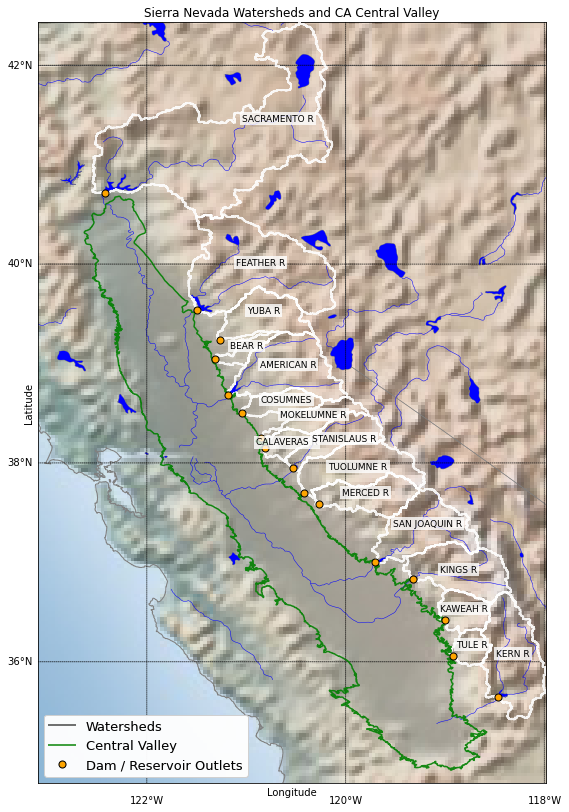

In [6]:
def draw_polys(gdf, mpl_map, facecolor = "red",  alpha = 0.3, edgecolor = 'black', lw = 1, fill = True, zorder = 3):
    
    '''
    Turns a geopandas gdf of multipolygons into matplotlib polygon patches for friendly plotting with basemap. 
    '''
    
    for index, row in gdf.iterrows():
        lats = []
        lons = []
        for pt in list(row['geometry'].exterior.coords): 
            lats.append(pt[1])
            lons.append(pt[0])

        x, y = m( lons, lats )
        xy = zip(x,y)
        poly = Polygon(list(xy), fc=facecolor, alpha=alpha, ec = edgecolor ,lw = lw, fill = fill, zorder = zorder)
        plt.gca().add_patch(poly)

    return


def draw_points(gdf, mpl_map, sizecol = None, color = 'red', alpha = 0.7, edgecolor = None, fill = True, zorder = 4):
    '''
    Turns a geopandas gdf of points into matplotlib lat/lon objects for friendly plotting with basemap. 
    '''
    lats = []
    lons = []
    for index, row in gdf.iterrows():
         for pt in list(row['geometry'].coords): 
            lats.append(pt[1])
            lons.append(pt[0])
    
    if sizecol is None:
        sizecol = 50
    else:
        sizecol = sizecol.values
    
    m.scatter(lons, lats, latlon=True, s = sizecol, alpha=alpha, c = color, edgecolor = edgecolor, zorder = zorder)


# Load outlets shapefile
outlets = gp.read_file('../shape/outlets.shp')

# Load cv shapefile
cv = gp.read_file('../shape/cv.shp')

# Get the bbox using rasterio 
src = rio.open("../rasters/flowacc_clip.tif")

# get bbox of data
imextent = src.bounds
lllon, lllat = imextent[0], imextent[1]
urlon, urlat = imextent[2], imextent[3]

# Setup fig 
f, ax1 = plt.subplots(1,1,figsize=(22,14))

# Initialize the basemap
m = Basemap(ax = ax1,epsg='4326', ellps='WGS84',resolution='f', llcrnrlon=lllon, urcrnrlon=urlon, llcrnrlat=lllat, urcrnrlat=urlat,
            lat_0= (lllat + urlat) / 2, lon_0= (lllon + urlon) / 2)

# Add stuff to basemap 
m.shadedrelief(zorder = 0)
m.drawcoastlines(color='gray', zorder = 2)
m.drawcountries(color='gray', zorder = 2)
m.drawstates(color='gray', zorder = 2)
m.drawrivers(color = "blue", zorder = 2)
m.fillcontinents(color='none',lake_color='blue', zorder = 2)

# Draw lines of latitude and longitude. Labels are like [left,right,top,bottom]
parallels = np.arange(0.,90.,2.)
meridians = np.arange(0.,360.,2.)

m.drawparallels(parallels,labels=[True,False,True,False]) # [left,right,top,bottom]
m.drawmeridians(meridians,labels=[True,False,False,True]) # [left,right,top,bottom]

# Draw the watersheds we delineated
draw_polys(catchments, m, alpha = 0.9, edgecolor = 'white', lw = 1.5, fill = False)
draw_polys(cv, m, alpha = 0.9, edgecolor = 'green', lw = 1.5, fill = False)
draw_points(outlets,m, alpha = 1,  color= 'orange', edgecolor = 'black')

# Get some coords for shed labels
c = catchments.copy()
c['coords'] = c['geometry'].apply(lambda x: x.representative_point().coords[:])
c['coords'] = [coords[0] for coords in c['coords']]

# Label the sheds
for idx, row in c.iterrows():
    ax1.text(row.coords[0], row.coords[1], s=row['catch_name'], horizontalalignment='center', size = 9,
    bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'}, zorder= 5)

# Titles and albels 
ax1.set_title("Sierra Nevada Watersheds and CA Central Valley")
ax1.set_ylabel("Latitude")
ax1.set_xlabel("Longitude")

# Make the legend (lower left of map)
custom_lines = [Line2D([0], [0], color='black',markeredgecolor = 'black', alpha = 0.5, lw=2),
                Line2D([0], [0], color='green',markeredgecolor = 'black', alpha = 0.7, lw=2),
                Line2D([0], [0], linewidth=0, marker='o', markersize=7, markeredgecolor = 'black',markerfacecolor="orange"),
                ]

leg1 = ax1.legend(custom_lines, ["Watersheds", "Central Valley",'Dam / Reservoir Outlets'],
                    loc = "lower left",
                    prop={'size':13})

ax1.add_artist(leg1)

plt.show()

# Plot in Budyko Space

### Budyko equation: 

###  $$ \frac{AET}{P}  = [{\Phi * tanh(\Phi^{-1}) (1-e^{\Phi})}]^{\frac{1}{2}} $$ 

where $\Phi = \frac{PET}{P} $

<ipython-input-8-5575c93dd2fb>:13: RuntimeWarning: divide by zero encountered in double_scalars
  budyko_y = np.array([np.sqrt((x*np.tanh(x**-1)*(1-np.exp(-x)))) for x in budyko_x])


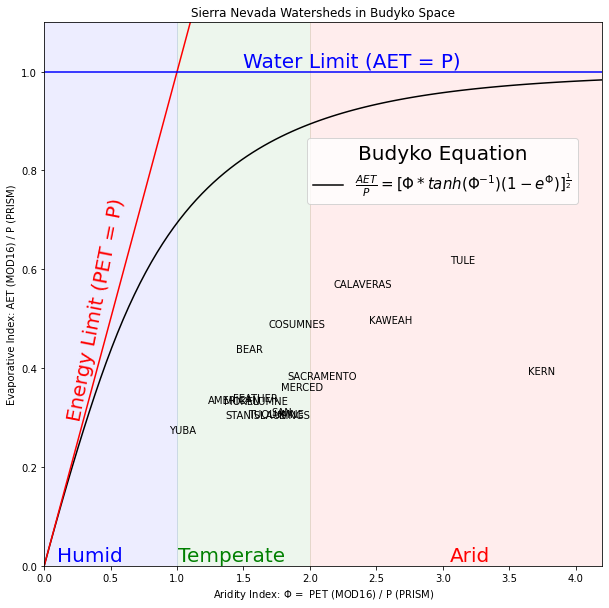

In [8]:
# Budyko plot
plt.figure(figsize = (10,10))

for k,v in budyko_dict.items():
    
    basinstr = k.split()[0]
    
    plt.scatter(v[1],v[0],alpha = 0)
    plt.text(v[1], v[0], basinstr, fontsize = 10)
    
# Ploy budyko equation shown above
budyko_x = np.linspace(0, 4.2, 100)
budyko_y = np.array([np.sqrt((x*np.tanh(x**-1)*(1-np.exp(-x)))) for x in budyko_x])
plt.plot(budyko_x,budyko_y, color = 'black',
         label = r'$ \frac{AET}{P}  = [{\Phi * tanh(\Phi^{-1}) (1-e^{\Phi})}]^{\frac{1}{2}} $')

# Put budyko eq in legend
plt.legend(bbox_to_anchor=[0.97, 0.8], loc='upper right', fontsize = 15, title = "Budyko Equation", title_fontsize = 20)

# Plot water and energy limits
plt.plot([-10,10],[-10,10],  color='r', linestyle='-')
plt.axhline(y=1, color='blue', linestyle='-')

plt.text(1.5,1.01, 'Water Limit (AET = P)', color = 'blue', size = 20)
plt.text(0.16,0.3, 'Energy Limit (PET = P)', color = 'red', size = 20, rotation = np.degrees(np.pi/2.28))

# Plot shaded climate zones 
plt.axvspan(0, 1, alpha=0.07, color='blue')
plt.axvspan(1, 2, alpha=0.07, color='green')
plt.axvspan(2, 4.5, alpha=0.07, color='red')

plt.text(0.1,0.01, 'Humid', color = 'blue', size = 20)
plt.text(1.01,0.01, 'Temperate', color = 'green', size = 20)
plt.text(3.05,0.01, 'Arid', color = 'red', size = 20)

plt.ylabel("Evaporative Index: AET (MOD16) / P (PRISM)")
plt.xlabel(r"Aridity Index: $\Phi$ =  PET (MOD16) / P (PRISM)")
# plt.xscale('log')
# plt.yscale('log')

plt.ylim([0,1.1])
plt.xlim([0,4.2])

plt.title("Sierra Nevada Watersheds in Budyko Space")
plt.show()

# Plot map / Budyko together

<ipython-input-9-9f1e228a30d7>:85: RuntimeWarning: divide by zero encountered in double_scalars
  budyko_y = np.array([np.sqrt((x*np.tanh(x**-1)*(1-np.exp(-x)))) for x in budyko_x])


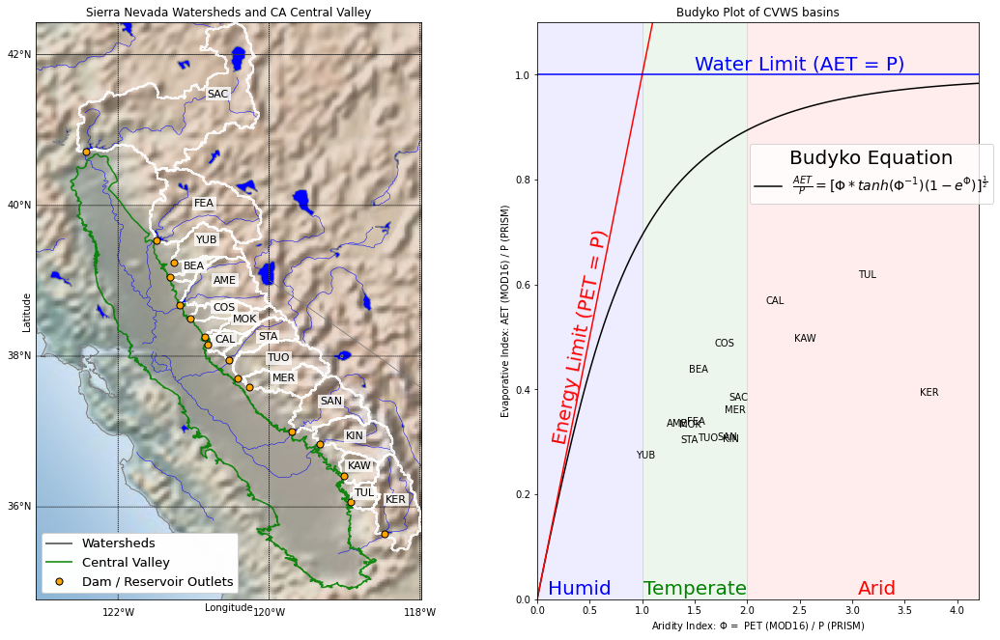

In [9]:
# Load outlets shapefile
outlets = gp.read_file('../shape/outlets.shp')

# Load cv shapefile
cv = gp.read_file('../shape/cv.shp')

# Get the bbox using rasterio 
src = rio.open("../rasters/flowacc_clip.tif")

# get bbox of data
imextent = src.bounds
lllon, lllat = imextent[0], imextent[1]
urlon, urlat = imextent[2], imextent[3]

# Setup the figure
plt.figure(figsize=(18, 11))
G = gridspec.GridSpec(5, 2)

# Plot the basemaps in ax1
ax1 = plt.subplot(G[:, 0:1])

# Initialize the basemap
m = Basemap(ax = ax1,epsg='4326', ellps='WGS84',resolution='f', llcrnrlon=lllon, urcrnrlon=urlon, llcrnrlat=lllat, urcrnrlat=urlat,
            lat_0= (lllat + urlat) / 2, lon_0= (lllon + urlon) / 2)

# Add stuff to basemap 
m.shadedrelief(zorder = 0)
m.drawcoastlines(color='gray')
m.drawcountries(color='gray')
m.drawstates(color='gray')
m.drawrivers(color = "blue")
m.fillcontinents(color='none',lake_color='blue')

# Draw lines of latitude and longitude. Labels are like [left,right,top,bottom]
parallels = np.arange(0.,90.,2.)
meridians = np.arange(0.,360.,2.)

m.drawparallels(parallels,labels=[True,False,True,False]) # [left,right,top,bottom]
m.drawmeridians(meridians,labels=[True,False,False,True]) # [left,right,top,bottom]

# Draw the shapefiles
draw_polys(c, m, alpha = 0.9, edgecolor = 'white', lw = 1.5, fill = False)
draw_polys(cv, m, alpha = 0.9, edgecolor = 'green', lw = 1.5, fill = False)
draw_points(outlets,m, alpha = 1,  color= 'orange', edgecolor = 'black')

# Label the sheds
for idx, row in c.iterrows():
    ax1.text(row.coords[0], row.coords[1], s=row['catch_name'].split()[0][:3], horizontalalignment='center', size = 11,
    bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'}, zorder= 5)


    
# Titles and labels 
ax1.set_title("Sierra Nevada Watersheds and CA Central Valley")
ax1.set_ylabel("Latitude")
ax1.set_xlabel("Longitude")

# Make the first legend (upper left of map)
custom_lines = [Line2D([0], [0], color='black',markeredgecolor = 'black', alpha = 0.5, lw=2),
                Line2D([0], [0], color='green',markeredgecolor = 'black', alpha = 0.7, lw=2),
                Line2D([0], [0], linewidth=0, marker='o', markersize=7, markeredgecolor = 'black',markerfacecolor="orange"),
                ]

leg1 = ax1.legend(custom_lines, ["Watersheds", "Central Valley",'Dam / Reservoir Outlets'],
                    loc = "lower left",
                    prop={'size':13})

ax1.add_artist(leg1)

# Add legends
ax1.add_artist(leg1)

# Plot the Budyko plot
ax2 = plt.subplot(G[:, 1:2])

for k,v in budyko_dict.items():
    
    basinstr = k.split()[0]
    
    ax2.scatter(v[1],v[0],alpha = 0)
    ax2.text(v[1], v[0], basinstr[:3], fontsize = 10)
    
# Ploy budyko equation shown above
budyko_x = np.linspace(0, 4.2, 100)
budyko_y = np.array([np.sqrt((x*np.tanh(x**-1)*(1-np.exp(-x)))) for x in budyko_x])
plt.plot(budyko_x,budyko_y, color = 'black',
         label = r'$ \frac{AET}{P}  = [{\Phi * tanh(\Phi^{-1}) (1-e^{\Phi})}]^{\frac{1}{2}} $')

# Put budyko eq in legend
plt.legend(bbox_to_anchor=[1.05, 0.8], loc='upper right', fontsize = 14, title = "Budyko Equation", title_fontsize = 20)
    
# Plot water and energy limits    
ax2.plot([-10,10],[-10,10],  color='r', linestyle='-')
ax2.axhline(y=1, color='blue', linestyle='-')

# Plot shaded climate zones 
ax2.axvspan(0, 1, alpha=0.07, color='blue')
ax2.axvspan(1, 2, alpha=0.07, color='green')
ax2.axvspan(2, 4.2, alpha=0.07, color='red')

# Text on the plot 
ax2.text(1.5,1.01, 'Water Limit (AET = P)', color = 'blue', size = 20)
ax2.text(0.13,0.3, 'Energy Limit (PET = P)', color = 'red', size = 20, rotation = np.degrees(np.pi/2.28))

ax2.text(0.1,0.01, 'Humid', color = 'blue', size = 20)
ax2.text(1.01,0.01, 'Temperate', color = 'green', size = 20)
ax2.text(3.05,0.01, 'Arid', color = 'red', size = 20)

# Axis labels 
ax2.set_ylabel("Evaporative Index: AET (MOD16) / P (PRISM)")
ax2.set_xlabel(r"Aridity Index: $\Phi$ =  PET (MOD16) / P (PRISM)")

ax2.set_ylim([0,1.1])
ax2.set_xlim([0,4.2])

ax2.set_title("Budyko Plot of CVWS basins")

G.update(wspace=0.2, hspace=0.3) # set the spacing between axes. 

plt.show()

### TODO: kmeans clustering? on budyko plot with K = 3???

# Make a plot of ΔS for each basin

In [10]:
# Concatenate the ΔS sum for each watershed we calculated in the first loop to a single gdf 
ds_catches = gp.GeoDataFrame(pd.DataFrame(pd.concat(catch_ds)))

# Calculate ΔS as cm - divide by the catchment area and convert km to cm (1e5)
ds_catches['ds_sum_cm'] = ds_catches['ds_sum'] / ds_catches['area_km2'] * 1e5

In [11]:
plot_list = ['SIERRA','SAC','FEA', "AMER", "TUO", "SAN", "KAW", "KER"]
colorlist = ['purple','green','orange','pink','blue','gray','red','brown']

# Plot volumetric ($km^3$) Change in $\Delta S_{gw}$ 

<ipython-input-12-534b94fe0085>:111: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


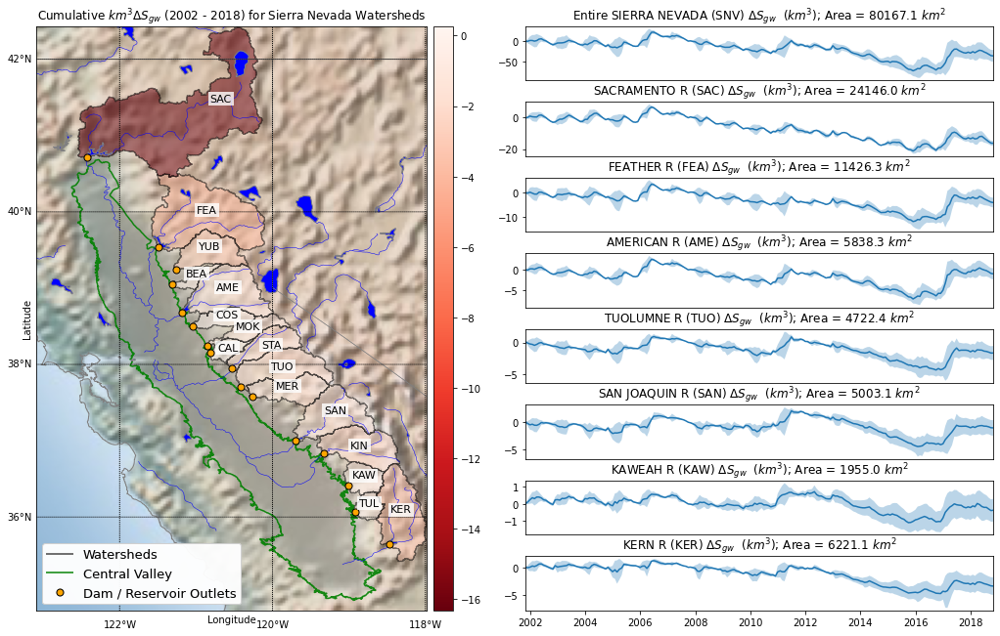

In [12]:
# Load outlets shapefile
outlets = gp.read_file('../shape/outlets.shp')

# Load cv shapefile
cv = gp.read_file('../shape/cv.shp')

# Get the bbox using rasterio 
src = rio.open("../rasters/flowacc_clip.tif")

# get bbox of data
imextent = src.bounds
lllon, lllat = imextent[0], imextent[1]
urlon, urlat = imextent[2], imextent[3]

# Setup the figure
plt.figure(figsize=(18, 11))
G = gridspec.GridSpec(8, 2)

# Plot the basemaps in ax1
ax1 = plt.subplot(G[:, 0:1])

# Initialize the basemap
m = Basemap(ax = ax1,epsg='4326', ellps='WGS84',resolution='f', llcrnrlon=lllon, urcrnrlon=urlon, llcrnrlat=lllat, urcrnrlat=urlat,
            lat_0= (lllat + urlat) / 2, lon_0= (lllon + urlon) / 2)

# Add stuff to basemap 
m.shadedrelief(zorder = 0)
m.drawcoastlines(color='gray')
m.drawcountries(color='gray')
m.drawstates(color='gray')
m.drawrivers(color = "blue")
m.fillcontinents(color='none',lake_color='blue')

# Draw lines of latitude and longitude. Labels are like [left,right,top,bottom]
parallels = np.arange(0.,90.,2.)
meridians = np.arange(0.,360.,2.)

m.drawparallels(parallels,labels=[True,False,True,False]) # [left,right,top,bottom]
m.drawmeridians(meridians,labels=[True,False,False,True]) # [left,right,top,bottom]

# Setup the colorbar
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
mappable = plt.cm.ScalarMappable(cmap = 'RdBu')
vmin = ds_catches['ds_sum'].min()
vmax = ds_catches['ds_sum'].max()

# Plot catchments, color by Δs
ds_catches.plot(ax=ax1,column = 'ds_sum',alpha = 0.5, edgecolor='black',cmap = 'Reds_r',legend = False)
sm = plt.cm.ScalarMappable(cmap='Reds_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbr = plt.colorbar(sm, cax=cax,)

# Plot CV and outlets 
cv.plot(ax=ax1,alpha = 0.9, facecolor="none", edgecolor = 'green', lw = 1.5)
draw_points(outlets,m, alpha = 1,  color= 'orange', edgecolor = 'black')

# Label the sheds
for idx, row in c.iterrows():
    ax1.text(row.coords[0], row.coords[1], s=row['catch_name'].split()[0][:3], horizontalalignment='center', size = 11,
    bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'}, zorder= 5)

# Titles and labels 
ax1.set_title('Cumulative $km^3 ΔS_{gw}$ (2002 - 2018) for Sierra Nevada Watersheds')
ax1.set_ylabel("Latitude")
ax1.set_xlabel("Longitude")

# Make the second legend (lower left of map)
custom_lines = [Line2D([0], [0], color='black',markeredgecolor = 'black', alpha = 0.5, lw=2),
                Line2D([0], [0], color='green',markeredgecolor = 'black', alpha = 0.7, lw=2),
                Line2D([0], [0], linewidth=0, marker='o', markersize=7, markeredgecolor = 'black',markerfacecolor="orange"),
                ]

leg1 = ax1.legend(custom_lines, ["Watersheds", "Central Valley",'Dam / Reservoir Outlets'],
                    loc = "lower left",
                    prop={'size':13})

ax1.add_artist(leg1)

# Plot the time series for the selected sheds 
plot_list = ['SIERRA NEVADA','SAC','FEA', "AMER", "TUO", "SAN", "KAW", "KER"]

for idx,i in enumerate(plot_list):
    
    # Get catchment area, abbreviation, and name 
    cname = [x for x in catchments.catch_name if i in x]
    if len(cname) ==0:
        area = round(catchments['area_km2'].sum(),1)
        cname = "Entire " + i
        abbv = "SNV"
    else:
        area = round(catchments[catchments['catch_name'] == cname[0]].area_km2.values[0],1)
        cname = " ".join(cname)
        abbv = cname.split()[0][:3]
        
    # Setup the subplot 
    ax = plt.subplot(G[idx:idx+1, 1:])
    df = [v for k,v in dsdf_dict.items() if i in k][0]
    
    # Plot the ΔS
    ax.plot(df['ds_mean'])
    ax.set_xlim(df['ds_mean'].dropna().index[0],df['ds_mean'].dropna().index[-1])
    ax.fill_between(df.index,df['ds_min'].astype(float),df['ds_max'].astype(float), alpha = 0.3)
    ax.set_title(cname + " (" +abbv+ ") "+ '$ΔS_{gw}$  $(km^3)$; Area = ' + str(area) + " $km^2$")

    if not idx == len(plot_list)-1:
        ax.get_xaxis().set_visible(False)

G.update(wspace=0.1, hspace=0.4) # set the spacing between axes. 

plt.tight_layout()
plt.show()

# Plot change in $\Delta S_{gw}$ as equivalent water thickness (cm)

<ipython-input-13-21ac0a7c820d>:112: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


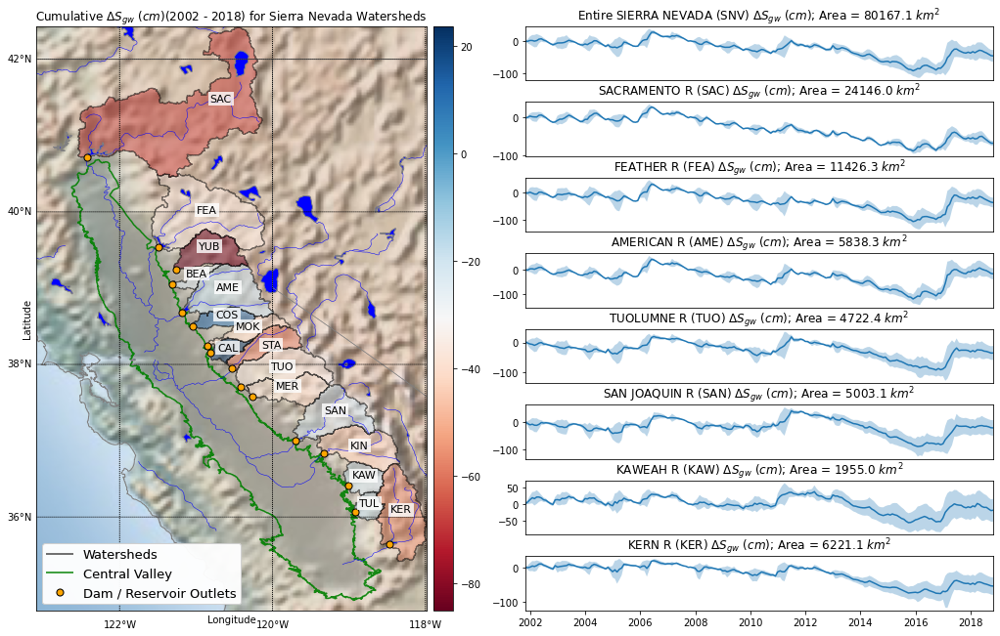

In [13]:
# Load outlets shapefile
outlets = gp.read_file('../shape/outlets.shp')

# Load cv shapefile
cv = gp.read_file('../shape/cv.shp')

# Get the bbox using rasterio 
src = rio.open("../rasters/flowacc_clip.tif")

# get bbox of data
imextent = src.bounds
lllon, lllat = imextent[0], imextent[1]
urlon, urlat = imextent[2], imextent[3]

# Setup the figure
plt.figure(figsize=(18, 11))
G = gridspec.GridSpec(8, 2)

# Plot the basemaps in ax1
ax1 = plt.subplot(G[:, 0:1])

# Initialize the basemap
m = Basemap(ax = ax1,epsg='4326', ellps='WGS84',resolution='f', llcrnrlon=lllon, urcrnrlon=urlon, llcrnrlat=lllat, urcrnrlat=urlat,
            lat_0= (lllat + urlat) / 2, lon_0= (lllon + urlon) / 2)

# Add stuff to basemap 
m.shadedrelief(zorder = 0)
m.drawcoastlines(color='gray')
m.drawcountries(color='gray')
m.drawstates(color='gray')
m.drawrivers(color = "blue")
m.fillcontinents(color='none',lake_color='blue')

# Draw lines of latitude and longitude. Labels are like [left,right,top,bottom]
parallels = np.arange(0.,90.,2.)
meridians = np.arange(0.,360.,2.)

m.drawparallels(parallels,labels=[True,False,True,False]) # [left,right,top,bottom]
m.drawmeridians(meridians,labels=[True,False,False,True]) # [left,right,top,bottom]

# Setup the colorbar
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
mappable = plt.cm.ScalarMappable(cmap = 'RdBu')
vmin = ds_catches['ds_sum_cm'].min()
vmax = ds_catches['ds_sum_cm'].max()

# Plot catchments, color by Δs
ds_catches.plot(ax=ax1,column = 'ds_sum_cm',alpha = 0.5, edgecolor='black',cmap = 'RdBu',legend = False)

sm = plt.cm.ScalarMappable(cmap='RdBu', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbr = plt.colorbar(sm, cax=cax,)

# Plot CV and outlets 
cv.plot(ax=ax1,alpha = 0.9, facecolor="none", edgecolor = 'green', lw = 1.5)
draw_points(outlets,m, alpha = 1,  color= 'orange', edgecolor = 'black')

# Label the sheds
for idx, row in c.iterrows():
    ax1.text(row.coords[0], row.coords[1], s=row['catch_name'].split()[0][:3], horizontalalignment='center', size = 11,
    bbox={'facecolor': 'white', 'alpha':0.8, 'pad': 2, 'edgecolor':'none'}, zorder= 5)

# Titles and labels 
ax1.set_title('Cumulative $ΔS_{gw}$ $(cm)$(2002 - 2018) for Sierra Nevada Watersheds')
ax1.set_ylabel("Latitude")
ax1.set_xlabel("Longitude")

# Make the second legend (lower left of map)
custom_lines = [Line2D([0], [0], color='black',markeredgecolor = 'black', alpha = 0.5, lw=2),
                Line2D([0], [0], color='green',markeredgecolor = 'black', alpha = 0.7, lw=2),
                Line2D([0], [0], linewidth=0, marker='o', markersize=7, markeredgecolor = 'black',markerfacecolor="orange"),
                ]

leg1 = ax1.legend(custom_lines, ["Watersheds", "Central Valley",'Dam / Reservoir Outlets'],
                    loc = "lower left",
                    prop={'size':13})

ax1.add_artist(leg1)

# Plot the time series for the selected sheds 
plot_list = ['SIERRA NEVADA','SAC','FEA', "AMER", "TUO", "SAN", "KAW", "KER"]

for idx,i in enumerate(plot_list):
    
    # Get catchment area, abbreviation, and name 
    cname = [x for x in catchments.catch_name if i in x]
    if len(cname) ==0:
        area = round(catchments['area_km2'].sum(),1)
        cname = "Entire " + i
        abbv = "SNV"
    else:
        area = round(catchments[catchments['catch_name'] == cname[0]].area_km2.values[0],1)
        cname = " ".join(cname)
        abbv = cname.split()[0][:3]
        
    # Setup the subplot 
    ax = plt.subplot(G[idx:idx+1, 1:])
    df = [v for k,v in dsdf_dict.items() if i in k][0]
    
    # Plot the ΔS
    ax.plot(df['ds_mean'] / area * 1e5)
    ax.set_xlim(df['ds_mean'].dropna().index[0],df['ds_mean'].dropna().index[-1])
    ax.fill_between(df.index,df['ds_min'].astype(float)/ area * 1e5,df['ds_max'].astype(float)/ area * 1e5, alpha = 0.3)
    ax.set_title(cname + " (" +abbv+ ") "+ '$ΔS_{gw}$ $(cm)$; Area = ' + str(area) + " $km^2$")

    if not idx == len(plot_list)-1:
        ax.get_xaxis().set_visible(False)

G.update(wspace=0.1, hspace=0.4) # set the spacing between axes. 

plt.tight_layout()
plt.show()

# Make animation

In [14]:
# Setup objects for animation 

# Get list of all the dates
dates = list(dsdf_dict['SIERRA NEVADA'].index)
ndates = len(dates)

# Setup out list of gdfs
d_gdfs = []

# Loop through dates and get a gdf with ['ds'] col for each date that you can pass to animation func 
for idx,d in enumerate(dates[:]):
    date_dict={}
    for k,v in dsdf_dict.items():
        dsmin = v.iloc[v.index==d].ds_min # min
        ds = v.iloc[v.index==d].ds_mean  # mean
        dsmax = v.iloc[v.index==d].ds_max # max
        date_dict[k] = [dsmin.values[0], ds.values[0], dsmax.values[0]] # min, mean, max 
    
    catch_dfs = []
                        
    for k,v in date_dict.items():
        cdf = catchments[catchments['catch_name'] == k]
        cdf['ds_min_cm'] = v[0] / cdf['area_km2'] * 1e5 # min
        cdf['ds_mean_cm'] = v[1] / cdf['area_km2'] * 1e5 # mean
        cdf['ds_max_cm'] = v[2] / cdf['area_km2'] * 1e5 # max
        if not cdf.empty:
            catch_dfs.append(cdf)

    gdf_d_t = pd.concat(catch_dfs)
    d_gdfs.append(gdf_d_t)


<ipython-input-14-e0239ebf013f>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cdf['ds_min_cm'] = v[0] / cdf['area_km2'] * 1e5 # min
<ipython-input-14-e0239ebf013f>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cdf['ds_mean_cm'] = v[1] / cdf['area_km2'] * 1e5 # mean
<ipython-input-14-e0239ebf013f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.

In [15]:
# Calc the min, mean, max for whole sierra at each time step 

dsvals = []
for i in d_gdfs:
    dsvals.append(i['ds_mean_cm'].values)
    
vmin = np.min([item for sublist in dsvals for item in sublist])
vmax = np.max([item for sublist in dsvals for item in sublist])

dsmin = dsdf_dict['SIERRA NEVADA']['ds_min'] / catchments['area_km2'].sum() * 1e5
dsmean = dsdf_dict['SIERRA NEVADA']['ds_mean'] / catchments['area_km2'].sum() * 1e5
dsmax = dsdf_dict['SIERRA NEVADA']['ds_max'] / catchments['area_km2'].sum() * 1e5

In [16]:
# Load outlets shapefile for plot
outlets = gp.read_file('../shape/outlets.shp')

# Load cv shapefile for plot
cv = gp.read_file('../shape/cv.shp')

# Get the bbox using rasterio 
src = rio.open("../rasters/flowacc_clip.tif")

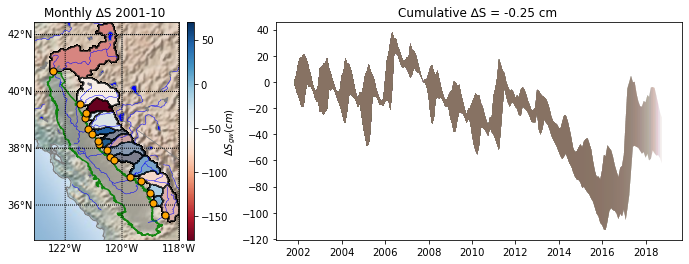

In [17]:
# Make animation

# Setup fig 
f, ax = plt.subplots(figsize=(12,4))

# Select the first fig on left 
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
ax1 = plt.subplot(gs[0])

# get bbox of data
imextent = src.bounds
lllon, lllat = imextent[0], imextent[1]
urlon, urlat = imextent[2], imextent[3]

# Initialize the basemap in WGS84 and set the bbox and zoom 
m = Basemap(ax = ax1,epsg='4326', ellps='WGS84',resolution='f', llcrnrlon=lllon, urcrnrlon=urlon, llcrnrlat=lllat, urcrnrlat=urlat,
            lat_0= (lllat + urlat) / 2, lon_0= (lllon + urlon) / 2)

# Add stuff to basemap 
m.shadedrelief(zorder = 0)
m.drawcoastlines(color='gray')
m.drawcountries(color='gray')
m.drawstates(color='gray')
m.drawrivers(color = "blue")
m.fillcontinents(color='none',lake_color='blue')

# Draw lines of latitude and longitude. Labels are like [left,right,top,bottom]
parallels = np.arange(0.,90.,2.)
meridians = np.arange(0.,360.,2.)

m.drawparallels(parallels,labels=[True,False,True,False]) # [left,right,top,bottom]
m.drawmeridians(meridians,labels=[True,False,False,True]) # [left,right,top,bottom]

# Setup the colorbar
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
mappable = plt.cm.ScalarMappable(cmap = 'RdBu')

# Plot the gdf and color by Δs (cm)
d_gdfs[0].plot(ax=ax1,column = 'ds_mean_cm',alpha = 0.5, edgecolor='black',cmap = 'RdBu',legend = False)

sm = plt.cm.ScalarMappable(cmap='RdBu', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbr = plt.colorbar(sm, cax=cax)

# Plot CV and outlets 
cv.plot(ax=ax1,alpha = 0.9, facecolor="none", edgecolor = 'green', lw = 1.5)
draw_points(outlets,m, alpha = 1,  color= 'orange', edgecolor = 'black')

# Titles and labels 
ax1.set_title('$ΔS_{gw}$ $(cm)$(2002 - 2018) for Sierra Nevada')

# Plot the line 
ax2 = plt.subplot(gs[1])
line, = ax2.plot(dates,dsmean,color='k')
ax2.set_ylabel("$\Delta S_{gw} (cm)$")
ax2.set_title("Cumulative ∆S (cm) for Sierra Nevada")

###### Animation Functions
def animate(frame):
    d_gdfs[frame].plot(ax=ax1,column = 'ds_mean_cm',alpha = 0.5, edgecolor='black',cmap = 'RdBu',legend = False)
    line.set_data(dates[:frame],dsmean[:frame])
    ax2.fill_between(dates[:frame], dsmin[:frame], dsmax[:frame], alpha = 0.1)
    ax1.set_title("Monthly ∆S {} ".format(str(dates[frame])[:-12]))
    ax2.set_title("Cumulative ∆S = {} cm ".format(str(round(dsmean[frame],2))))

    
# Finally, use the animation module to create the animation.
ani = animation.FuncAnimation(
    f,               # figure
    animate,         # name of the function above
    frames= len(dsmean),       # Could also be iterable or list
    interval=250, # ms between frames
    repeat = True
)

HTML(ani.to_jshtml())

In [ ]:
ani.save("../images/dS_anim.gif", writer='pillow')

In [ ]:
# Make animation

# Setup fig 
f, ax = plt.subplots(figsize=(12,4))

# get bbox of data
imextent = src.bounds
lllon, lllat = imextent[0], imextent[1]
urlon, urlat = imextent[2], imextent[3]

# Select the first fig on left 
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
ax1 = plt.subplot(gs[0])

# Initialize the basemap
m = Basemap(ax = ax1,epsg='4326', ellps='WGS84',resolution='f', llcrnrlon=lllon, urcrnrlon=urlon, llcrnrlat=lllat, urcrnrlat=urlat,
            lat_0= (lllat + urlat) / 2, lon_0= (lllon + urlon) / 2)

# Add stuff to basemap 
m.shadedrelief(zorder = 0)
m.drawcoastlines(color='gray')
m.drawcountries(color='gray')
m.drawstates(color='gray')
m.drawrivers(color = "blue")
m.fillcontinents(color='none',lake_color='blue')

# Draw lines of latitude and longitude. Labels are like [left,right,top,bottom]
parallels = np.arange(0.,90.,2.)
meridians = np.arange(0.,360.,2.)

m.drawparallels(parallels,labels=[True,False,True,False]) # [left,right,top,bottom]
m.drawmeridians(meridians,labels=[True,False,False,True]) # [left,right,top,bottom]

# Setup the colorbar
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
mappable = plt.cm.ScalarMappable(cmap = 'RdBu')

# Plot catchments, color by Δs
d_gdfs[0].plot(ax=ax1,column = 'ds_mean_cm',alpha = 0.5, edgecolor='black',cmap = 'RdBu',legend = False)

sm = plt.cm.ScalarMappable(cmap='RdBu', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbr = plt.colorbar(sm, cax=cax,)

# Plot CV and outlets 
cv.plot(ax=ax1,alpha = 0.9, facecolor="none", edgecolor = 'green', lw = 1.5)
draw_points(outlets,m, alpha = 1,  color= 'orange', edgecolor = 'black')

# Titles and labels 
ax1.set_title('$ΔS_{gw}$ $(cm)$(2002 - 2018) for Sierra Nevada')

# Plot the line 
ax2 = plt.subplot(gs[1])
line, = ax2.plot(dates,dsmean,color='k')
ax2.set_ylabel("$\Delta S_{gw} (cm)$")
ax2.set_title("Cumulative ∆S (cm) for Sierra Nevada")

###### Animation Functions
def animate(frame):
    d_gdfs[frame].plot(ax=ax1,column = 'ds_mean_cm',alpha = 0.5, edgecolor='black',cmap = 'RdBu',legend = False)
    line.set_data(dates[:frame],dsmean[:frame])
    p = plt.fill_between(dates, dsmin, dsmax, alpha = 0.2, cmap ='gray')
    ax1.set_title("{} ∆S = {} cm ".format(str(dates[frame])[:-12],str(round(d_gdfs[frame]['ds_mean_cm'].sum(),2))))
    ax2.set_title("Cumulative ∆S = {} cm ".format(str(round(dsmean[frame],2))))

    return line, p
    
# Finally, use the animation module to create the animation.
ani = animation.FuncAnimation(
    f,               # figure
    animate,         # name of the function above
    frames= len(ds_sums),       # Could also be iterable or list
    interval=250, # ms between frames
    repeat = True
)

HTML(ani.to_jshtml())

In [ ]:
# Make animation

# Setup fig 
f, ax = plt.subplots(figsize=(12,4))

# get bbox of data
imextent = src.bounds
lllon, lllat = imextent[0], imextent[1]
urlon, urlat = imextent[2], imextent[3]

# Select the first fig on left 
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
ax1 = plt.subplot(gs[0])

# Initialize the basemap
m = Basemap(ax = ax1,epsg='4326', ellps='WGS84',resolution='f', llcrnrlon=lllon, urcrnrlon=urlon, llcrnrlat=lllat, urcrnrlat=urlat,
            lat_0= (lllat + urlat) / 2, lon_0= (lllon + urlon) / 2)

# Add stuff to basemap 
m.shadedrelief(zorder = 0)
m.drawcoastlines(color='gray')
m.drawcountries(color='gray')
m.drawstates(color='gray')
m.drawrivers(color = "blue")
m.fillcontinents(color='none',lake_color='blue')

# Draw lines of latitude and longitude. Labels are like [left,right,top,bottom]
parallels = np.arange(0.,90.,2.)
meridians = np.arange(0.,360.,2.)

m.drawparallels(parallels,labels=[True,False,True,False]) # [left,right,top,bottom]
m.drawmeridians(meridians,labels=[True,False,False,True]) # [left,right,top,bottom]

# Setup the colorbar
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.1)
mappable = plt.cm.ScalarMappable(cmap = 'RdBu')

# Plot catchments, color by Δs
d_gdfs[0].plot(ax=ax1,column = 'ds_mean_cm',alpha = 0.5, edgecolor='black',cmap = 'RdBu',legend = False)

sm = plt.cm.ScalarMappable(cmap='RdBu', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbr = plt.colorbar(sm, cax=cax,)

# Plot CV and outlets 
cv.plot(ax=ax1,alpha = 0.9, facecolor="none", edgecolor = 'green', lw = 1.5)
draw_points(outlets,m, alpha = 1,  color= 'orange', edgecolor = 'black')

# Titles and labels 
ax1.set_title('$ΔS_{gw}$ $(cm)$(2002 - 2018) for Sierra Nevada')

# Plot the line 
ax2 = plt.subplot(gs[1])
line, = ax2.plot(dates,dsmean,color='k')
ax2.set_ylabel("$\Delta S_{gw} (cm)$")
ax2.set_title("Cumulative ∆S (cm) for Sierra Nevada")

###### Animation Functions
def animate(frame):
    d_gdfs[frame].plot(ax=ax1,column = 'ds_mean_cm',alpha = 0.5, edgecolor='black',cmap = 'RdBu',legend = False)
    line.set_data(dates[:frame],dsmean[:frame])
    ax2.fill_between(dates[:frame], dsmin[:frame], dsmax[:frame], alpha = 0.2, cmap ='gray')
#     p = plt.fill_between(dates, dsmin, dsmax, alpha = 0.2, cmap ='gray')
    ax1.set_title("{} ∆S = {} cm ".format(str(dates[frame])[:-12],str(round(d_gdfs[frame]['ds_mean_cm'].sum(),2))))
    ax2.set_title("Cumulative ∆S = {} cm ".format(str(round(dsmean[frame],2))))

#     return line, p
    
# Finally, use the animation module to create the animation.
ani = animation.FuncAnimation(
    f,               # figure
    animate,         # name of the function above
    frames= len(ds_sums),       # Could also be iterable or list
    interval=250, # ms between frames
    repeat = True
)

HTML(ani.to_jshtml())